# Исследование рынка заведений общественного питания Москвы

Инициатор исследования - инвестиционный фонд «Shut Up and Take My Money». Инвесторы рассматривают возможность открыть заведение общественного питания в Москве.

Цель проекта - подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

Инвесторы пока не определились с категорией заведения (кафе, ресторан, пиццерия, паб или бар), с ценовой политикой и расположением. Однако, основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве.
Дополнительная задача проекта - исследовать возможности категории кофеен, и дать рекомендацию для открытия нового заведения

В качестве источника данных доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Описание данных**  

Файл `moscow_places.csv`:  

•	`name` — название заведения;  
•	`address` — адрес заведения;  
•	`category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;  
•	`hours` — информация о днях и часах работы;  
•	`lat` — широта географической точки, в которой находится заведение;  
•	`lng` — долгота географической точки, в которой находится заведение;  
•	`rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);  
•	`price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;  
•	`avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:  
&ensp;&ensp;&ensp;&ensp; o	*«Средний счёт: 1000–1500 ₽»;*  
&ensp;&ensp;&ensp;&ensp; o	*«Цена чашки капучино: 130–220 ₽»;*  
&ensp;&ensp;&ensp;&ensp; o	*«Цена бокала пива: 400–600 ₽».*  
&ensp;&ensp;&ensp;&ensp; *и так далее;*  
•	`middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:   
&ensp;&ensp;&ensp;&ensp; o	*Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.*  
&ensp;&ensp;&ensp;&ensp; o	*Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.*  
&ensp;&ensp;&ensp;&ensp; o	*Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.*  
•	`middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:   
&ensp;&ensp;&ensp;&ensp; o	*Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.* 
&ensp;&ensp;&ensp;&ensp; o	*Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.*  
&ensp;&ensp;&ensp;&ensp; o	*Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.* 
•	`chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);  
•	`district` — административный район, в котором находится заведение, например Центральный административный округ;
•	`seats` — количество посадочных мест.  


<a id="0"></a> <br>
# Оглавление

* [1.  Загрузка данных](#article1)  
* [2.  Предобработка данных](#article2) 
    * [2.1  поиск дубликатов](#subart21) 
    * [2.2  заполнение пропусков](#subart22) 
    * [2.3  предобработка. добавление колонок](#subart23) 
* [3.  Анализ данных](#article3) 
    * [3.1  оценка количества заведений по категориям](#subart31) 
    * [3.2  оценка заведений по количеству посадочных мест](#subart32)
    * [3.3  распределение заведений Москвы по типу: сетевые и несетевые](#subart33)
    * [3.4  обзор популярных сетевых заведений Москвы](#subart34)
    * [3.5  распределение заведений по административным районам Москвы](#subart35)
    * [3.6  распределение по среднему рейтингу заведения](#subart36)
    * [3.7  распределение среднего рейтинга заведений по районам Москвы](#subart37)
    * [3.8  анализ улиц по количеству представленных заведений](#subart38)
    * [3.9  распределение среднего чека по районам Москвы](#subart39)
    * [3.10  дополнительный анализ](#subart310)
        * [3.10.1  анализ круглосуточных заведений](#subsub3101)
        * [3.10.2  сравнение сетевых и несетевых заведений](#subsub3102)
    * [3.11  выводы по Рынку заведений общественного питания Москвы](#subart311)
* [4.  Исследование категории кофеен](#article4) 
    * [4.1  сравнение сетевых и несетевых кофеен](#subart41)
    * [4.2  распределение кофеен по округам](#subart42)
    * [4.3  оценка наличия круглосуточных кофеен](#subart43)
    * [4.4  основные выводы по категории кофеен](#subart44)
* [5.  Общие итоги по проекту](#article5) 
* [6.  Материалы](#article6) 

<a id="article1"></a>
## Загрузка данных

In [1]:
pip install squarify

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import squarify
from plotly import graph_objects as go
from plotly.subplots import make_subplots
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster

In [3]:
data = pd.read_csv('/datasets/moscow_places.csv' )
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Данные содержат большое количество пропусков.
Пропуски присутствуют в колонках:  `hours`, `price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`, `seats`.

Преобразований по формату данных не требуется

<a id="article2"></a>
## Предобработка данных

<a id="subart21"></a>
### поиск дубликатов

In [5]:
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [6]:
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [7]:
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

In [8]:
data['chain'].unique()

array([0, 1])

In [9]:
list( data['name'].drop_duplicates().sort_values(ascending=False).head(20))

['ночной Баку',
 'Яуза',
 'Ясно',
 'Ясмин',
 'Яръ',
 'Ярославский',
 'Ярославна',
 'Ярмарка морских блюд',
 'Яркофе',
 'Япоша',
 'Японский пёс',
 'Японский король',
 'Японские традиции',
 'Японская кухня',
 'ЯпонаМать',
 'Янтарь',
 'Янис',
 'Яндекс.Лавка',
 'Яндекс Лавка',
 'Яндекс Еда']

In [10]:
data ['name'] = data ['name'].str.lower()
data ['name'] = data ['name'].str.replace('яндекс.лавка', 'яндекс лавка',  regex=True)
data ['name'] = data ['name'].str.replace('wild bean cafe', 'wild bean')
data ['name'] = data ['name'].str.replace('the wild bean', 'wild bean')
data ['name'] = data ['name'].str.replace('синнабон', 'cinnabon')
data ['name'] = data ['name'].str.replace('jeffrey\'s coffeeshop', 'jeffrey\'s coffee')
data ['name'] = data ['name'].str.replace('white fox cafe', 'white fox')
data ['name'] = data ['name'].str.replace('чудо-печка', 'чудо печка')
data ['name'] = data ['name'].str.replace('чайхана', 'чайхона')
data ['name'] = data ['name'].str.replace('чайхона №1', 'чайхона № 1')
data ['name'] = data ['name'].str.replace('чайхона ош', 'чайхона ош')
data ['name'] = data ['name'].str.replace('-gали', ' gали')
data ['name'] = data ['name'].str.replace('gали!', 'gали')
data ['name'] = data ['name'].str.replace('хинкали-gaли', 'хинкали gали')
data ['name'] = data ['name'].str.replace('хинкали - gали', 'хинкали gали')
data ['name'] = data ['name'].str.replace('фо бо и том ям', 'фо бо & том ям')
data ['name'] = data ['name'].str.replace('хищnik', 'хищnik стейкs & burgers')

In [11]:
data.duplicated().sum()

0

In [12]:
data.duplicated(['name', 'address']).sum()

3

In [13]:
data[data.duplicated(['name', 'address'], keep=False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


По сочетанию столбцов name + address найдено три совпадения. Тем не мене при совпадении названия и адреса в совпавших строках содержалась противоречивая информация о категории заведения, часах работы, принадлежности к сети. Автоматическое удаление дубликатов не подходит, так не очевидно, какая информация является истинной или ложной.  
Отталкиваясь от информации в открытых источниках, удаляем те строки, которые содержат ложные данные.  

In [14]:
data = data.drop(index = [1511, 2420, 3109]).reset_index(drop=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8403 entries, 0 to 8402
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8403 non-null   object 
 1   category           8403 non-null   object 
 2   address            8403 non-null   object 
 3   district           8403 non-null   object 
 4   hours              7868 non-null   object 
 5   lat                8403 non-null   float64
 6   lng                8403 non-null   float64
 7   rating             8403 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8403 non-null   int64  
 13  seats              4792 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.2+ KB


В базе достаточно много неявных дубликатов, связанных с произвольным написанием наименований заведений, включая лишние пробелы, тире, точки, разный язык. Произведены замены, там где такие дубликаты были обнаружены.

Было найдено три дублика по совпадению колонок `name` + `address`, дубликаты удалены

<a id="subart22"></a>
### заполнение пропусков

In [15]:
data.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 535
lat                     0
lng                     0
rating                  0
price                5088
avg_bill             4587
middle_avg_bill      5254
middle_coffee_cup    7868
chain                   0
seats                3611
dtype: int64

In [16]:
data [data['chain']== 1]['name'].count()

3203

In [17]:
data [data['chain']== 1]['name'].nunique()

738

In [18]:
data [data['chain']== 1].isna().sum()

name                    0
category                0
address                 0
district                0
hours                 116
lat                     0
lng                     0
rating                  0
price                2066
avg_bill             1738
middle_avg_bill      2017
middle_coffee_cup    2940
chain                   0
seats                1278
dtype: int64

В базе 738 наименований сетевых заведений, на которые приходится 3203 точки. Среди сетевых заведений так же содержится много пропусков. Частично можно попробовать заполнить пропуски, опираясь на сетевые данные.

In [19]:
data.query('chain == 1').groupby('name')[['hours','price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup']].apply(lambda x: x.isna().sum()).sort_values(by='middle_avg_bill',ascending=False).head()

,hours,price,avg_bill,middle_avg_bill,middle_coffee_cup
name,,,,,
шоколадница,0,68,46,108,58
яндекс лавка,1,72,72,72,72
one price coffee,0,70,65,71,65
cofix,0,58,30,65,30
кофепорт,0,41,12,42,12


На примере нескольких крупных сетей видим единообразие и стандарты в ценовой политике. То есть пропуски в колонках `price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`	можно заполнить ориентируясь, на сетевые данные, там где возможно.

По времени работы единообразия нет: внутри одной сети могут быть заведения с разным графиком работы. Вводных для заполнения пропуска по колонке `hours` нет.

Аналогично можно сказать о количестве посадочных мест в заведениях - эти пропуски оставим без заполнения.

In [20]:
data.query('name == "шоколадница"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
151,шоколадница,кофейня,"Москва, Дмитровское шоссе, 163Ак1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.910447,37.542227,4.1,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN
240,шоколадница,кофейня,"Москва, Широкая улица, 13А",Северо-Восточный административный округ,"ежедневно, 10:00–21:00",55.887990,37.662485,4.1,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,75.0
343,шоколадница,кофейня,"Москва, Фестивальная улица, 13, корп. 1",Северный административный округ,"ежедневно, 08:00–23:00",55.855703,37.477670,4.3,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,100.0
360,шоколадница,кофейня,"Москва, Сходненская улица, 25",Северо-Западный административный округ,"ежедневно, 08:00–23:00",55.846066,37.438897,4.3,средние,Цена чашки капучино:239–274 ₽,NaN,256.0,1,130.0
381,шоколадница,кофейня,"Москва, Сходненская улица, 56",Северо-Западный административный округ,"ежедневно, 10:00–22:00",55.850700,37.443523,4.3,NaN,NaN,NaN,NaN,1,140.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7648,шоколадница,кофейня,"Москва, Кировоградская улица, 14",Южный административный округ,"ежедневно, 10:00–22:00",55.622498,37.606618,4.3,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,48.0
7667,шоколадница,кофейня,"Москва, Профсоюзная улица, 129А",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.619023,37.506517,4.1,NaN,NaN,NaN,NaN,1,180.0
7674,шоколадница,кофейня,"Москва, Варшавское шоссе, 140",Южный административный округ,"ежедневно, 10:00–22:00",55.611830,37.608381,4.2,NaN,NaN,NaN,NaN,1,NaN
7894,шоколадница,кофейня,"Москва, Ореховый бульвар, 14к3",Южный административный округ,"ежедневно, 10:00–22:00",55.609682,37.720095,4.2,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN


In [21]:
chain_data = data.query('chain == 1').groupby('name').agg({'price':'first','avg_bill':'first','middle_avg_bill':'median', 'middle_coffee_cup':'median' }).add_prefix('chain_').reset_index()
chain_data.head(10)

,name,chain_price,chain_avg_bill,chain_middle_avg_bill,chain_middle_coffee_cup
0,1-я креветочная,None,None,NaN,NaN
1,10 идеальных пицц,None,None,NaN,NaN
2,18 грамм,средние,Цена чашки капучино:100–200 ₽,NaN,150.0
3,4 сезона,None,None,NaN,NaN
4,7 сэндвичей,средние,Средний счёт:от 300 ₽,300.0,NaN
5,8 вафель,None,None,NaN,NaN
6,9 bar coffee,None,Цена чашки капучино:60–150 ₽,NaN,127.0
7,abc coffee roasters,None,None,NaN,NaN
8,air coffee,средние,Цена чашки капучино:90–170 ₽,NaN,130.0
9,americano black coffee & food,выше среднего,Средний счёт:700–1000 ₽,850.0,NaN


In [22]:
data = data.merge(chain_data, on = 'name', how = 'left')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,chain_price,chain_avg_bill,chain_middle_avg_bill,chain_middle_coffee_cup
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,NaN,NaN,NaN,NaN
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,NaN,NaN,NaN,NaN
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,NaN,NaN,NaN,NaN
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,средние,Средний счёт:400–600 ₽,550.0,NaN


In [23]:
data['price']=data['price'].fillna(data['chain_price'])
data['avg_bill']=data['avg_bill'].fillna(data['chain_avg_bill'])
data['middle_avg_bill']=data['middle_avg_bill'].fillna(data['chain_middle_avg_bill'])
data['middle_coffee_cup']=data['middle_coffee_cup'].fillna(data['chain_middle_coffee_cup'])

In [24]:
data.isna().sum()

name                          0
category                      0
address                       0
district                      0
hours                       535
lat                           0
lng                           0
rating                        0
price                      3946
avg_bill                   3620
middle_avg_bill            4391
middle_coffee_cup          7539
chain                         0
seats                      3611
chain_price                6110
chain_avg_bill             5955
chain_middle_avg_bill      6342
chain_middle_coffee_cup    7810
dtype: int64

За счет сетевых данных удалось заполнить пропуски примерно для 1000 пропущенных значений в каждой из колонок `price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`

Остальные пропуски заменим фразой "не указано"

In [25]:
data['hours']=data['hours'].fillna('не указано')
data['price']=data['price'].fillna('не указано')
data['avg_bill']=data['avg_bill'].fillna('не указано')

In [26]:
data.isna().sum()

name                          0
category                      0
address                       0
district                      0
hours                         0
lat                           0
lng                           0
rating                        0
price                         0
avg_bill                      0
middle_avg_bill            4391
middle_coffee_cup          7539
chain                         0
seats                      3611
chain_price                6110
chain_avg_bill             5955
chain_middle_avg_bill      6342
chain_middle_coffee_cup    7810
dtype: int64

In [27]:
# дополнительно убедимся, что строке в колонке avg_bill, которая хранит среднюю стоимость заказа в виде диапазона, 
# и содержит запись "Цена чашки капучино: ..", соответствует запись в колонке middle_coffee_cup

len (data[(data['avg_bill'].str.contains('Цена чашки капучино') == True) & (data['middle_coffee_cup'].isna() )])

0

In [28]:
# дополнительно убедимся, что строке в колонке avg_bill, которая хранит среднюю стоимость заказа в виде диапазона, 
# и содержит запись "Средний счёт: ..", соответствует запись в колонке middle_avg_bill

len (data[(data['avg_bill'].str.contains('Средний счёт') == True) & (data['middle_avg_bill'].isna() )])

0

Выводы: пропуски в данных, относящихся к ценообрзованию (`price`, `avg_bill`, `middle_avg_bill`, `middle_coffee_cup`) были частично заполнены за счет данных по сетевым заведениям.
Пропуски в данных по `hours` и `seats` оставлены без заполнения

<a id="subart23"></a>
### предобработка. добавление колонок

In [29]:
# Структура написания адреса в колонке address стандартная: "Москва, улица , номер дома"
# Выделим название улицы, удалив название города "Москва," , и, затем, удалив все содержание после первой запятой

data ['street'] = data['address'].str.replace('Москва, ', '')
data['street'] = data['street'].str.partition(', ')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,chain_price,chain_avg_bill,chain_middle_avg_bill,chain_middle_coffee_cup,street
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,не указано,не указано,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,улица Дыбенко
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,NaN,NaN,NaN,NaN,улица Дыбенко
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,NaN,NaN,NaN,NaN,Клязьминская улица
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,не указано,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,NaN,NaN,NaN,NaN,улица Маршала Федоренко
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,средние,Средний счёт:400–600 ₽,550.0,NaN,Правобережная улица


In [30]:
data['street'].nunique()

1448

In [31]:
list( data.loc [data['hours'].str.contains('ежедневно') == True]['hours'].drop_duplicates().sort_values(ascending=False).head(20))

['ежедневно, круглосуточно',
 'ежедневно, 22:00–06:00',
 'ежедневно, 21:00–04:00',
 'ежедневно, 19:00–06:00',
 'ежедневно, 18:50–06:00',
 'ежедневно, 18:00–06:00',
 'ежедневно, 18:00–05:30',
 'ежедневно, 18:00–05:00',
 'ежедневно, 18:00–02:00',
 'ежедневно, 17:00–05:00',
 'ежедневно, 17:00–00:00',
 'ежедневно, 16:00–23:00',
 'ежедневно, 16:00–06:00',
 'ежедневно, 16:00–04:00',
 'ежедневно, 16:00–00:00',
 'ежедневно, 15:00–05:00',
 'ежедневно, 15:00–04:00',
 'ежедневно, 15:00–00:00',
 'ежедневно, 14:00–23:00',
 'ежедневно, 14:00–22:00']

In [32]:
data['is_24/7'] = data['hours'].str.contains('ежедневно, круглосуточно')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,chain_price,chain_avg_bill,chain_middle_avg_bill,chain_middle_coffee_cup,street,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,не указано,не указано,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,NaN,NaN,NaN,NaN,улица Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,NaN,NaN,NaN,NaN,Клязьминская улица,False
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,не указано,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,NaN,NaN,NaN,NaN,улица Маршала Федоренко,False
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,средние,Средний счёт:400–600 ₽,550.0,NaN,Правобережная улица,False


In [33]:
data [data['is_24/7']==True]['name'].count()

730

Добавлены колонки с названием улицы, а так же с указанием круглосуточных заведений

<a id="article3"></a>
## Анализ данных

<a id="subart31"></a>
### оценка количества заведений по категориям

In [34]:
data['name'].count()

8403

In [35]:
category_count = data.groupby('category')['name'].count().sort_values(ascending = False).reset_index(name='count')
category_count ['share'] = (category_count ['count']/category_count ['count'].sum()).map(lambda x: '{0:.1%}'.format(x))
category_count

,category,count,share
0,кафе,2377,28.3%
1,ресторан,2042,24.3%
2,кофейня,1413,16.8%
3,"бар,паб",764,9.1%
4,пиццерия,633,7.5%
5,быстрое питание,603,7.2%
6,столовая,315,3.7%
7,булочная,256,3.0%


In [36]:
fig = px.bar(category_count.sort_values(by='count', ascending=True), 
             x='count', 
             y='category', 
             text='count',
             color_discrete_sequence=['#346456'],
            )
fig.update_layout(title='Распределение объектов общественного питания Москвы по категориям',
                   xaxis_title='Количество объектов',
                   yaxis_title='Категория заведений')
fig.show()

В базе насчитывается 8406 заведений точек общественного питания.  
Всего в базе  8 катеорий заведений общепита.   
Топ 3 категории суммарно занимают 69% от общей численности заведений: (1) кафе - 28% , (2) рестораны - 24% , (3) кофейни - 17%

<a id="subart32"></a>
### оценка заведений по количеству посадочных мест

In [37]:
data.groupby('category')['seats'].describe().T

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
count,467.000000,148.000000,349.000000,1217.000000,751.000000,427.000000,1269.000000,164.000000
mean,124.477516,89.385135,98.891117,97.365653,111.199734,94.496487,121.892041,99.750000
std,145.162278,97.685844,106.611739,117.922464,127.837772,112.282703,123.792216,122.951453
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,48.000000,25.000000,28.000000,35.000000,40.000000,30.000000,48.000000,40.000000
50%,82.000000,50.000000,65.000000,60.000000,80.000000,55.000000,86.000000,75.500000
75%,148.500000,120.000000,140.000000,120.000000,144.000000,120.000000,150.000000,117.000000
max,1288.000000,625.000000,1040.000000,1288.000000,1288.000000,1288.000000,1288.000000,1200.000000


In [38]:
fig = px.box(data.query('seats < 340'), x='seats', y='category')
fig.update_layout(title='Распределение заведений по количеству посадочных в разрезе категорий заведений',
                   xaxis_title='Количество посадочных мест',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                 )
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

In [39]:
(len(data.query('seats <340'))/(len(data) - data['seats'].isna().sum())).round(2)

0.96

In [40]:
round((len(data.query('seats <340'))/len(data)), 2)

0.55

В базе есть некоторе количество заведений, для которых указано слишком большое количество посадочных мест - до 1288, которые на  диаграмме разброса определяются как аномальные выбросы.  
Так как выборка по количеству посадочных мест и так ограничена изза пропусков, возьмем 340 мест как границу для отсечения выбросов.  
Таким образом, мы исключаем 4% от предоставленных данных. И у нас остается 55% данных по количеству мест, доступных для анализа с учетом пропусков.

In [41]:
 data.query('seats <340')['seats'].median()

70.0

In [42]:
seats_data = data.query('seats <340').groupby('category')['seats'].median().sort_values(ascending = False).reset_index()
seats_data

,category,seats
0,"бар,паб",80.0
1,ресторан,80.0
2,столовая,72.0
3,кофейня,70.0
4,быстрое питание,60.0
5,кафе,57.0
6,пиццерия,50.0
7,булочная,49.5


In [43]:
fig = px.bar(seats_data, 
             x='seats', 
             y='category', 
             text='seats',
             color_discrete_sequence=['#346456'],
            )
fig.update_layout(title='Медианные значения по количеству посадочных мест по категориям заведений в Москве',
                   xaxis_title='Количество посадочных мест / медиана',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.show()

Выводы по количеству мест:  медианное значение количества мест в заведениях в Москве - 70.  
В ресторанах и барах - медианное количество мест выше - 80.  
В кафе, пиццериях, точках быстрого питанмя и булочных - ниже - от 50 до 60.  
В кофейнях и столовых на уровне среднего по городу - порядка 70.  

<a id="subart33"></a>
### распределение заведений Москвы по типу: сетевые и несетевые

In [44]:
data['chain'] = data['chain'].apply(lambda x: 'сетевое' if x == 1 else 'несетевое')

In [45]:
chain_count = data.groupby('chain')['name'].count().reset_index(name = 'count')
chain_count

,chain,count
0,несетевое,5200
1,сетевое,3203


In [46]:
fig = go.Figure(data=[go.Pie(labels=chain_count['chain'], 
                             values=chain_count['count'],
                             marker = dict(colors = ['#346456','#8CB64A']),
                             pull = [0.1, 0])]) 
fig.update_layout(title='Доля числа объектов питания по типу заведения',
                  width=500, 
                  height=500,
                  annotations=[dict(x=1.38, 
                                    y=1.05,
                                    text='Тип заведения',
                                    showarrow=False)])
fig.show() 

In [47]:
category_chain_count = data.groupby(['category', 'chain'])['name'].count(). sort_values(ascending = False).reset_index(name = 'count')
category_chain_count = category_chain_count.merge(category_count[['category', 'count']], on = 'category')
category_chain_count = category_chain_count.rename(columns={'count_x':'count','count_y': 'category_total'})
category_chain_count['chain_share'] = (category_chain_count['count']/category_chain_count['category_total']).map(lambda x: '{0:.1%}'.format(x))
category_chain_count

,category,chain,count,category_total,chain_share
0,кафе,несетевое,1598,2377,67.2%
1,кафе,сетевое,779,2377,32.8%
2,ресторан,несетевое,1313,2042,64.3%
3,ресторан,сетевое,729,2042,35.7%
4,кофейня,сетевое,720,1413,51.0%
5,кофейня,несетевое,693,1413,49.0%
6,"бар,паб",несетевое,596,764,78.0%
7,"бар,паб",сетевое,168,764,22.0%
8,быстрое питание,несетевое,371,603,61.5%
9,быстрое питание,сетевое,232,603,38.5%


In [48]:
fig = px.bar(category_chain_count.sort_values(by=['chain','count'], ascending=True), 
             x='count', 
             y='category', 
             color = 'chain',
             barmode="group",
             text='count',
             color_discrete_sequence=['#346456', '#8CB64A']
            )
fig.update_layout(title='Распределение объектов общественного питания Москвы по категориям по типам заведения',
                   xaxis_title='Количество объектов',
                   yaxis_title='Категория заведений',
                   legend_title = 'Тип заведения',
                   legend_traceorder= 'reversed')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

In [49]:
fig = px.bar(category_chain_count.sort_values(by=['chain','count'], ascending=True), 
             x='count', 
             y='category', 
             color = 'chain',
             #barmode="group",
             text='chain_share',
             color_discrete_sequence=['#346456', '#8CB64A']
            )
fig.update_layout(title='Доли объектов общественного питания Москвы по категориям по типам заведения',
                   xaxis_title='Количество объектов',
                   yaxis_title='Категория заведений',
                   legend_title = 'Тип заведения',
                   legend_traceorder= 'reversed')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

Выводы: всего в Москве соотношение сетевых и несетевых заведений 38% / 62% в пользу несетевых.  
В разрезе категорий, по большинству категорий несетевые заведения преобладают над сетевыми.  
Исключение составляю кофейни и пиццерии, где соотношение сетевых и несетевых заведений сопоставимо. А так же булочные, где преимущество у сетевых заведений.

<a id="subart34"></a>
### обзор популярных сетевых заведений Москвы

In [50]:
data_top_15 = data.query('chain == "сетевое"').groupby(['name','category'])['address'].count().sort_values(ascending = False).reset_index().head(15)
data_top_15

,name,category,address
0,шоколадница,кофейня,119
1,домино'с пицца,пиццерия,76
2,додо пицца,пиццерия,74
3,яндекс лавка,ресторан,72
4,one price coffee,кофейня,71
5,cofix,кофейня,65
6,prime,ресторан,49
7,кофепорт,кофейня,42
8,кулинарная лавка братьев караваевых,кафе,39
9,теремок,ресторан,36


In [51]:
fig = px.bar(data_top_15, 
             x='address',
             y='name', 
             color = 'category',
             text='address',
             color_discrete_sequence=['#0652DD','#EA2027', '#009432','#B53471','#F79F1F']
            )

fig.update_layout(title='Топ-15 популярных сетей в Москве',
                   xaxis_title='Количество объектов',
                   yaxis_title='Сетевые заведения',
                   legend_title = 'Категория заведения')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( data_top_15['name'])))
fig.show() 

Выводы:  
Среди списка ТОП-15 сетевых заведений преобладают кофейни (6 наименований из 15), Шоколадница является лидером с большим отрывом.   
Несмотря на то, что в целом пиццерии находятся на 5 месте по численности заведений, среди ТОП 15 сетей, 2 и 3 место занимают пиццерии.  
Кафе и рестораны представлены слабее, кафе в нижней части рэнкинга  

<a id="subart35"></a>
### распределение заведений по административным районам Москвы

In [52]:
distr_data =data.groupby('district')['address'].count().sort_values(ascending = False).reset_index()
distr_data['distr_share'] = (distr_data['address']/distr_data['address'].sum()).map(lambda x: '{0:.1%}'.format(x))
distr_data

,district,address,distr_share
0,Центральный административный округ,2242,26.7%
1,Северный административный округ,899,10.7%
2,Южный административный округ,892,10.6%
3,Северо-Восточный административный округ,890,10.6%
4,Западный административный округ,850,10.1%
5,Восточный административный округ,798,9.5%
6,Юго-Восточный административный округ,714,8.5%
7,Юго-Западный административный округ,709,8.4%
8,Северо-Западный административный округ,409,4.9%


In [53]:

fig = px.bar(distr_data,
             y ='address', 
             color = 'district',
             text='distr_share',
             color_discrete_sequence=['#CAD3C8','#0652DD','#EE5A24','#A3CB38','#009432','#FFC312','#ED4C67','#F79F1F','#12CBC4']
             )

fig.update_layout(title='Распределение заведений по административным районам Москвы',
                   xaxis_title='Район',
                   yaxis_title='Количество заведений',
                   legend_title = 'Район',
                   )
                                  
fig.update_xaxes(categoryorder='array', categoryarray= list(reversed( distr_data['district'])))
fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

In [54]:
moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles="Cartodb Positron")

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)

m

In [55]:
distr_category_data = data.groupby(['district','category'])['address'].count().sort_values(ascending = False).reset_index()
distr_category_data = distr_category_data.merge(category_count[['category','count']], on='category')
distr_category_data.columns = distr_category_data.columns.str.replace('count', 'category_total')
distr_category_data ['distr_share'] = (distr_category_data['address']/distr_category_data['category_total']).map(lambda x: '{0:.1%}'.format(x))
distr_category_data

,district,category,address,category_total,distr_share
0,Центральный административный округ,ресторан,670,2042,32.8%
1,Западный административный округ,ресторан,218,2042,10.7%
2,Южный административный округ,ресторан,202,2042,9.9%
3,Северный административный округ,ресторан,188,2042,9.2%
4,Северо-Восточный административный округ,ресторан,182,2042,8.9%
...,...,...,...,...,...
67,Юго-Западный административный округ,булочная,27,256,10.5%
68,Восточный административный округ,булочная,25,256,9.8%
69,Южный административный округ,булочная,25,256,9.8%
70,Юго-Восточный административный округ,булочная,13,256,5.1%


In [56]:
fig = px.bar(distr_category_data,
             x='address', 
             y='category', 
             color = 'district',
             text='distr_share' ,
             color_discrete_sequence=['#CAD3C8','#0652DD','#EE5A24','#A3CB38','#009432','#FFC312','#ED4C67','#F79F1F','#12CBC4']
            )
fig.update_layout(title='Распределение категорий заведений по административным районам Москвы',
                   xaxis_title='Количество объектов',
                   yaxis_title='Категория заведений',
                   legend_title = 'Округ',
                   #legend_traceorder= 'reversed'
                 )

fig.update_xaxes(categoryorder='array', categoryarray= list(reversed( distr_data['district'])))
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

Выводы:  
Самая высокая концентрация заведений в Центральном округе, там расположены 26% всех заведений Москвы.   
По остальным округам заведения распределены равномерно, в среднем доля района составляет 8..10%.  
Исключение составляет Северо-Западный Округ, на него приходтся 5% заведений.  

Разные категории заведений по разному распределены по округам: Самая большая концентрация в Центре - у баров, пабов - почти половина заведений сосредоточена в центральном округе.  
У кофеен и ресторанов доля Центрпального округа так же выше среднего - 30%..33%.  
У кафе и других категорий заведений, наоборот, доля Центрального округа ниже, и заведения рааспределены по округам более равномерно.  

<a id="subart36"></a>
### распределение по среднему рейтингу заведения

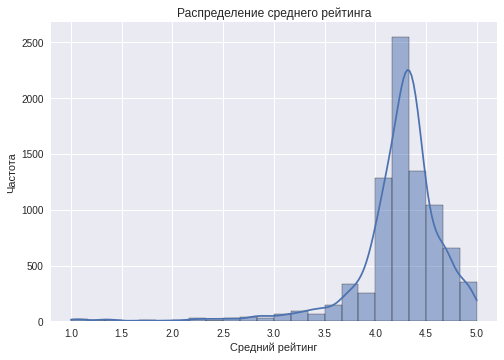

In [57]:
plt.style.use('seaborn')
sns.histplot(x='rating', data=data, bins = 24 ,kde=True)
plt.title('Распределение среднего рейтинга')
plt.xlabel('Средний рейтинг')
plt.ylabel('Частота')
plt.show()

In [58]:
data['rating'].describe().round(2)

count    8403.00
mean        4.23
std         0.47
min         1.00
25%         4.10
50%         4.30
75%         4.40
max         5.00
Name: rating, dtype: float64

In [59]:
data.groupby('category')['rating'].describe().T

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
count,764.000000,256.000000,603.000000,2377.000000,1413.000000,633.000000,2042.000000,315.000000
mean,4.387696,4.268359,4.050249,4.123896,4.277282,4.301264,4.290402,4.211429
std,0.380392,0.386303,0.560949,0.566200,0.372250,0.336162,0.413143,0.454205
min,1.100000,1.300000,1.100000,1.000000,1.400000,1.000000,1.000000,1.000000
25%,4.300000,4.200000,3.900000,4.000000,4.100000,4.200000,4.200000,4.100000
50%,4.400000,4.300000,4.200000,4.200000,4.300000,4.300000,4.300000,4.300000
75%,4.600000,4.400000,4.300000,4.400000,4.400000,4.400000,4.500000,4.400000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


In [60]:
rating_avg = data.groupby('category')['rating'].mean().round(2).sort_values(ascending = False).reset_index()
rating_avg

,category,rating
0,"бар,паб",4.39
1,пиццерия,4.30
2,ресторан,4.29
3,кофейня,4.28
4,булочная,4.27
5,столовая,4.21
6,кафе,4.12
7,быстрое питание,4.05


In [61]:
fig = px.box(data, x='rating', y='category')
fig.update_layout(title='Разброс рейтингов по категориям заведений',
                   xaxis_title='Рейтинг заведения',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

In [62]:
fig = px.bar(rating_avg, 
             x='rating', 
             y='category', 
             text='rating',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Средний рейтинг  по  категории заведений',
                   xaxis_title='Средний рейтинг',
                   xaxis_range = [4,4.5],
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                                      )
                   
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.add_vline(x=data['rating'].mean(), line_color = '#8CB64A', line_dash="dot", annotation_text=f" средний рейтинг в Москве  = {data['rating'].mean().round(2)}", 
              annotation_position="top right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.show()

Средний рейтинг заведения по Москве - 4.23.  
Самые высокие по уровню рейтинга заведения - в категории бары, пабы - средний рейтинг 4.39.  
Так же выше среднего оценивают заведения в категориях рестораны, кофейни, пиццерии и булочные - средгнний рейтинг в этих категориях 4.27..4.3.  
Ниже среднего заведения в категориях кафе и точки быстрого питания - они чаще других получают оценки ниже 3.5  

<a id="subart37"></a>
### распределение среднего рейтинга заведений по районам Москвы

In [63]:
fig = px.box(data, x='rating', y='district')
fig.update_layout(title='Разброс рейтингов по админимтративным районам',
                   xaxis_title='Рейтинг заведения',
                   yaxis_title='Район <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array',  categoryarray= list(reversed( distr_data['district'])))
fig.show()

In [64]:
rating_by_district = data.groupby('district')['rating'].mean().round(2).sort_values(ascending = False).reset_index()
rating_by_district 

,district,rating
0,Центральный административный округ,4.38
1,Северный административный округ,4.24
2,Северо-Западный административный округ,4.21
3,Западный административный округ,4.18
4,Южный административный округ,4.18
5,Восточный административный округ,4.17
6,Юго-Западный административный округ,4.17
7,Северо-Восточный административный округ,4.15
8,Юго-Восточный административный округ,4.10


In [65]:
fig = px.bar(rating_by_district, 
             x='rating', 
             y='district', 
             text='rating',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Средние оценки по  административным районам',
                   xaxis_title='Средняя оценка',
                   xaxis_range = [4,4.5],
                   yaxis_title='Район <br> (в порядке убывания кол-ва заведений)',
                                      )
                   
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( distr_data['district'])))

fig.add_vline(x=data['rating'].mean(), line_color = '#8CB64A', line_dash="dot", annotation_text=f" средний рейтинг в Москве  = {data['rating'].mean().round(2)}", 
              annotation_position="bottom right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.show()

In [66]:
state_geo = '/datasets/admin_level_geomap.geojson'

In [67]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

m

Выводы: Центральный округ лидирует по уровню заведений - средний рейтинг заведений самый высокий по Москве.  
Следом идёт Северный округ - там средний рейтинг заведений так же несколько выше среднего по Москве.  
Самый низкий средний рейтинг в Юго-Восточном округе.  
В остальных округах средний рейтинг сопоставим.  

<a id="subart38"></a>
### анализ улиц по количеству представленных заведений

In [68]:
streets_data = data.groupby(['street'])['name'].count().sort_values(ascending = False)
streets_data

street
проспект Мира              183
Профсоюзная улица          122
проспект Вернадского       108
Ленинский проспект         107
Ленинградский проспект      95
                          ... 
Павелецкая набережная        1
Панкратьевский переулок      1
Парусный проезд              1
Певческий переулок           1
№ 7                          1
Name: name, Length: 1448, dtype: int64

In [69]:
top15_streets = streets_data.head(15).reset_index(name = 'count')
top15_streets

,street,count
0,проспект Мира,183
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


In [70]:
one_place_street = streets_data [streets_data == 1]. reset_index(name = 'count')
one_place_street

,street,count
0,улица Фотиевой,1
1,улица Фадеева,1
2,улица Кирпичные Выемки,1
3,сад Эрмитаж,1
4,улица Ивана Франко,1
...,...,...
453,Павелецкая набережная,1
454,Панкратьевский переулок,1
455,Парусный проезд,1
456,Певческий переулок,1


In [71]:
(top15_streets['count'].sum()/data['name'].count()).round(2)

0.15

In [72]:
top_15_category = data[data['street'].isin(top15_streets['street'])].groupby('category')['name'].count().reset_index(name = 'count')
top_15_category

,category,count
0,"бар,паб",90
1,булочная,26
2,быстрое питание,117
3,кафе,353
4,кофейня,220
5,пиццерия,84
6,ресторан,327
7,столовая,40


In [73]:
fig = px.bar(top_15_category, 
             x='count', 
             y='category', 
             text='count',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Количество заведений по категориям на топ 15 улицах в Москве',
                   xaxis_title='Количество заведений',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.show()

In [74]:
top_15_street_category = data[data['street'].isin(top15_streets['street'])].groupby(['street','category'])['name'].count().reset_index(name = 'count')
top_15_street_category = top_15_street_category.merge(top15_streets, on = 'street')
top_15_street_category = top_15_street_category.merge(top_15_category, on = 'category')
top_15_street_category = top_15_street_category.rename(columns={'count_x':'count','count_y': 'street_total','count': 'category_total' })
top_15_street_category['category_share'] = (top_15_street_category['count']/top_15_street_category['street_total']).map(lambda x: '{0:.1%}'.format(x))
top_15_street_category  = top_15_street_category .sort_values(by = 'category_total', ascending = False)
top_15_street_category

,street,category,count,street_total,category_total,category_share
30,Варшавское шоссе,кафе,18,76,353,23.7%
43,улица Вавилова,кафе,15,55,353,27.3%
41,проспект Вернадского,кафе,25,108,353,23.1%
40,Пятницкая улица,кафе,7,48,353,14.6%
39,Профсоюзная улица,кафе,35,122,353,28.7%
...,...,...,...,...,...,...
106,Профсоюзная улица,булочная,4,122,26,3.3%
107,Пятницкая улица,булочная,3,48,26,6.2%
108,проспект Вернадского,булочная,1,108,26,0.9%
109,проспект Мира,булочная,4,183,26,2.2%


In [75]:
fig = px.bar(top_15_street_category,
             x='count', 
             y='street', 
             color = 'category',
             text='category_share' ,
                        )
fig.update_layout(title='Распределение категорий заведений по Топ 15 улицам Москвы',
                   xaxis_title='Количество объектов',
                   yaxis_title='топ 15 улиц',
                   legend_title = 'Категория',
                   yaxis={'categoryorder':'total ascending'},
                                                      )


fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

Топ 3 категори (кафе, рестораны, кофейни) являются основными на всех главных улицах.
На некоторых улицах (напр., Профсоюзная,Вернадского, Ленинский просп., и др.) рестораны выходят на первые позиции.
на МКАДе кафе доминируют - 69% заведений
на Улице Вавилова нетипично высокая доля точек быстрого питания.

In [76]:
top_15_rating = data[data['street'].isin(top15_streets['street'])].groupby('category')['rating'].mean().round(2).reset_index()
top_15_rating

,category,rating
0,"бар,паб",4.30
1,булочная,4.27
2,быстрое питание,4.05
3,кафе,4.10
4,кофейня,4.23
5,пиццерия,4.25
6,ресторан,4.29
7,столовая,4.21


In [77]:
fig = px.bar(top_15_rating, 
             x='rating', 
             y='category', 
             text='rating',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Средние оценки по категориям заведений для топ 15 улиц',
                   xaxis_title='Средняя оценка',
                   xaxis_range = [4,4.5],
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                                      )
                   
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.add_vline(x=data['rating'].mean(),line_color="#8CB64A", line_dash="dot", annotation_text=f" средний рейтинг в Москве  = {data['rating'].mean().round(2)}", 
              annotation_position="top right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.show()

In [78]:
data[data['street'].isin(top15_streets['street'])]['rating'].mean().round(2)

4.2

In [79]:
top_15_district = data[data['street'].isin(top15_streets['street'])].groupby('district')['name'].count().reset_index(name = 'count')
top_15_district['top_15_distr_share'] = (top_15_district['count']/top_15_district['count'].sum()).map(lambda x: '{0:.1%}'.format(x))
top_15_district = top_15_district.merge(distr_data, on ='district')
top_15_district = top_15_district.sort_values(by = 'address', ascending = False).reset_index(drop=True)
top_15_district

,district,count,top_15_distr_share,address,distr_share
0,Центральный административный округ,108,8.6%,2242,26.7%
1,Северный административный округ,232,18.5%,899,10.7%
2,Южный административный округ,197,15.7%,892,10.6%
3,Северо-Восточный административный округ,161,12.8%,890,10.6%
4,Западный административный округ,176,14.0%,850,10.1%
5,Восточный административный округ,2,0.2%,798,9.5%
6,Юго-Восточный административный округ,87,6.9%,714,8.5%
7,Юго-Западный административный округ,293,23.3%,709,8.4%
8,Северо-Западный административный округ,1,0.1%,409,4.9%


In [80]:
fig = px.bar(top_15_district,
             y ='count', 
             color = 'district',
             text='top_15_distr_share',
             color_discrete_sequence=['#CAD3C8','#0652DD','#EE5A24','#A3CB38','#009432','#FFC312','#ED4C67','#F79F1F','#12CBC4']
             )

fig.update_layout(title='Распределение заведений по административным районам для топ 15 улиц Москвы',
                   xaxis_title='Район',
                   yaxis_title='Количество заведений',
                   legend_title = 'Район <br> (в порядке убывания кол-ва заведений)',
                   #legend_traceorder= 'reversed'
                 )
                                  
fig.update_xaxes(categoryorder='array', categoryarray= list(reversed( top_15_district.index)))
fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

Выводы по ТОП 15 (по количеству заведений) улицам Москвы: 
в этот список попадают основные шоссе, как правило вне Центра, с преобладанием в Юго-Западном направлении.
На этих улицах сосредеточено 15% всех заведений Москвы.
Распределение по категориям заведений соответствует общемосковскому, с более высокой долей точек быстрого питания.
Средний рейтинг заведений чуть ниже чем в целом по Москве: 4.20 против 4.23.  

In [81]:
one_place_category = data[data['street'].isin(one_place_street['street'])].groupby('category')['name'].count().reset_index(name = 'count')
one_place_category

,category,count
0,"бар,паб",39
1,булочная,8
2,быстрое питание,23
3,кафе,160
4,кофейня,84
5,пиццерия,15
6,ресторан,93
7,столовая,36


In [82]:
fig = px.bar(one_place_category, 
             x='count', 
             y='category', 
             text='count' ,
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Количество заведений по категориям по улицам с 1им заведением в Москве',
                   xaxis_title='Количество заведений',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.show()

In [83]:
one_place_rating = data[data['street'].isin(one_place_street['street'])].groupby('category')['rating'].mean().round(2).reset_index()
one_place_rating

,category,rating
0,"бар,паб",4.48
1,булочная,4.34
2,быстрое питание,4.08
3,кафе,4.13
4,кофейня,4.31
5,пиццерия,4.37
6,ресторан,4.25
7,столовая,4.26


In [84]:
fig = px.bar(one_place_rating, 
             x='rating', 
             y='category', 
             text='rating',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Средние оценки по категориям заведений для улиц с 1 заведением',
                   xaxis_title='Средняя оценка',
                   xaxis_range = [4,4.5],
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                                      )
                   
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.add_vline(x=data['rating'].mean(), line_color  = '#8CB64A' ,line_dash="dot", annotation_text=f" средний рейтинг в Москве  = {data['rating'].mean().round(2)}", 
              annotation_position="top right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.show()

In [85]:
data[data['street'].isin(one_place_street['street'])]['rating'].mean().round(2)

4.24

In [86]:
one_place_district = data[data['street'].isin(one_place_street['street'])].groupby('district')['name'].count().reset_index(name = 'count')
one_place_district['one_place_distr_share'] = (one_place_district['count']/one_place_district['count'].sum()).map(lambda x: '{0:.1%}'.format(x))
one_place_district = one_place_district.merge(distr_data, on ='district')
one_place_district = one_place_district.sort_values(by = 'address', ascending = False).reset_index(drop=True)
one_place_district

,district,count,one_place_distr_share,address,distr_share
0,Центральный административный округ,145,31.7%,2242,26.7%
1,Северный административный округ,52,11.4%,899,10.7%
2,Южный административный округ,43,9.4%,892,10.6%
3,Северо-Восточный административный округ,55,12.0%,890,10.6%
4,Западный административный округ,35,7.6%,850,10.1%
5,Восточный административный округ,52,11.4%,798,9.5%
6,Юго-Восточный административный округ,39,8.5%,714,8.5%
7,Юго-Западный административный округ,18,3.9%,709,8.4%
8,Северо-Западный административный округ,19,4.1%,409,4.9%


In [87]:
fig = px.bar(one_place_district,
             y ='count', 
             color = 'district',
             text='one_place_distr_share',
             color_discrete_sequence=['#CAD3C8','#0652DD','#EE5A24','#A3CB38','#009432','#FFC312','#ED4C67','#F79F1F','#12CBC4']
             )

fig.update_layout(title='Распределение заведений по административным районам для улиц с 1им заведением',
                   xaxis_title='Район',
                   yaxis_title='Количество заведений',
                   legend_title = 'Район <br> (в порядке убывания кол-ва заведений)',
                   #legend_traceorder= 'reversed'
                 )
                                  
fig.update_xaxes(categoryorder='array', categoryarray= list(reversed( one_place_district.index)))
fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

Выводы по улицам с 1 заведениям:   
в этом списке 458 улиц и это как правило небольшие улицы и переулки, с более частым расположением в Центральном округе.  
По категориям заметно бОльшее присутствие кафе и столовых, меньше присутствие точек быстрого питания и пиццерий.  
Средний рейтинг не ниже среднего по Москве 4.24 против 4.23.  
В отдельных категориях средний рейтинг сущственно выше среднего: кофейни, пабы/бары, пиццерии и булочные.  

<a id="subart39"></a>
### распределение среднего чека по районам Москвы

In [88]:
data['middle_avg_bill'].describe()

count     4012.000000
mean       878.949651
std        930.504739
min          0.000000
25%        350.000000
50%        650.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

In [89]:
avg_middle_avg_bill = data.groupby('category')['middle_avg_bill'].median().round(2).sort_values(ascending = False).reset_index()
avg_middle_avg_bill

,category,middle_avg_bill
0,"бар,паб",1225.00
1,ресторан,1100.00
2,пиццерия,516.50
3,кофейня,512.50
4,кафе,500.00
5,быстрое питание,370.00
6,булочная,306.25
7,столовая,300.00


In [90]:
fig = px.bar(avg_middle_avg_bill, 
             x='middle_avg_bill', 
             y='category', 
             text='middle_avg_bill',
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Средние чек по категориям заведений',
                   xaxis_title='Средний чек',
                   #xaxis_range = [4,4.5],
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                                      )
                   
fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))

fig.add_vline(x=data['middle_avg_bill'].median(), line_color ='#8CB64A' , line_dash="dot", annotation_text=f" средний  чек в Москве  = {data['middle_avg_bill'].median().round(2)}", 
              annotation_position="top right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.show()

In [91]:
fig = px.box(data.query('middle_avg_bill < 5500'), x='middle_avg_bill', y='category')
fig.update_layout(title='Разброс среднего чека по категориям заведений',
                   xaxis_title='Средний чек',
                   yaxis_title='категория <br> (в порядке убывания кол-ва заведений)',
                 )
fig.update_yaxes(categoryorder='array',  categoryarray= list(reversed( category_count['category'])))
fig.show()

In [92]:
fig = px.box(data.query('middle_avg_bill < 5500'), x='middle_avg_bill', y='district')
fig.update_layout(title='Разброс среднего чека по админимтративным районам',
                   xaxis_title='Средний чек',
                   yaxis_title='Район <br> (в порядке убывания кол-ва заведений)')
fig.update_yaxes(categoryorder='array',  categoryarray= list(reversed( distr_data['district'])))
fig.show()

In [93]:
avg_bill_by_district = data.groupby('district')['middle_avg_bill'].median().round(2).sort_values(ascending = False).reset_index()
avg_bill_by_district

,district,middle_avg_bill
0,Центральный административный округ,950.0
1,Западный административный округ,675.0
2,Северо-Западный административный округ,600.0
3,Юго-Западный административный округ,537.5
4,Северный административный округ,512.5
5,Восточный административный округ,500.0
6,Северо-Восточный административный округ,500.0
7,Южный административный округ,500.0
8,Юго-Восточный административный округ,450.0


In [94]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=avg_bill_by_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='BuGn',
    fill_opacity=0.8,
    legend_name='Средний чек по районам',
).add_to(m)

m

Выводы по среднему чеку: Средний (медианный) чек по Москве - 650. Однако, в данных имеется большой разброс, который связан как с категорией заведений, так и с районом.

Самый высоки средний чек в категориях Рестораны и пабы, бары. Самый низкий средний чек - в категориях точек быстрого питания, столовых и булочных.

Средний чек заведений ожидаемо выше в Центре, а так же на западе - Западный, Северо-Западный и Юго-Западный округа.
Самый низкий средний чек - в Юго-Восточном округе

In [95]:
fig = px.scatter(data, 
                 x="rating", 
                 y="middle_avg_bill", 
                 color="category",
                )
fig.update_layout(title='Разброс среднего чека и рейтинга заведения по категориям',
                   xaxis_title='Рейтинг',
                   yaxis_title='Средний чсек',
                 legend_title = 'Категория заведения',
                                   )

fig.update_yaxes(range = [0,5500])

fig.show()

Связи между рейтингом и средний чеком не наблюдается. Основаная масса точек расположена в диапазоне рейтинга 4-5, и среднего чека - до 1500.  
Однако наблюдается преобладание ресторанов и баров, пабов - в зоне дорогих заведений с высоким рейтингом,  
А преобладание кафе и точек быстрого питания - в зоне заведений с низким чеком и низкой оценкой  

<a id="subart310"></a>
### дополнительный анализ

<a id="subsub3101"></a>
#### анализ круглосуточных заведений

In [96]:
hd_24_avg = (data[data['is_24/7'] ==True]['name'].count()/len(data)).round(2)
hd_24_avg

0.09

In [97]:
hd_24_by_category = data[data['is_24/7'] ==True].groupby('category')['name'].count().reset_index(name= 'is_24/7')
hd_24_by_category = hd_24_by_category.merge(category_count, on = 'category').sort_values(by='count', ascending = False).reset_index(drop=True)
hd_24_by_category ['is_24/7_share'] = (hd_24_by_category ['is_24/7']/hd_24_by_category ['count']).map(lambda x: '{0:.1%}'.format(x))
hd_24_by_category

,category,is_24/7,count,share,is_24/7_share
0,кафе,267,2377,28.3%,11.2%
1,ресторан,135,2042,24.3%,6.6%
2,кофейня,59,1413,16.8%,4.2%
3,"бар,паб",52,764,9.1%,6.8%
4,пиццерия,31,633,7.5%,4.9%
5,быстрое питание,150,603,7.2%,24.9%
6,столовая,12,315,3.7%,3.8%
7,булочная,24,256,3.0%,9.4%


In [98]:
hd_24_by_district = data[data['is_24/7'] ==True].groupby('district')['name'].count().reset_index()
hd_24_by_district.rename(columns = {'name':'is_24/7'}, inplace = True )
hd_24_by_district = hd_24_by_district.merge(distr_data[['district', 'address']], on = 'district').sort_values(by='address', ascending = False).reset_index(drop=True)
hd_24_by_district ['is_24/7_share'] = (hd_24_by_district ['is_24/7']/hd_24_by_district ['address']).map(lambda x: '{0:.1%}'.format(x))
hd_24_by_district

,district,is_24/7,address,is_24/7_share
0,Центральный административный округ,131,2242,5.8%
1,Северный административный округ,71,899,7.9%
2,Южный административный округ,75,892,8.4%
3,Северо-Восточный административный округ,75,890,8.4%
4,Западный административный округ,72,850,8.5%
5,Восточный административный округ,97,798,12.2%
6,Юго-Восточный административный округ,93,714,13.0%
7,Юго-Западный административный округ,73,709,10.3%
8,Северо-Западный административный округ,43,409,10.5%


в Москве всего 9% заведений работают в круглосуточном режиме. здесь преобладают точки быстрого питания, расположенные вне Центра.

<a id="subsub3102"></a>
#### сравнение сетевых и несетевых заведений

In [99]:
chain_rating = data.groupby(['chain'])['rating'].mean(). sort_values(ascending = False).reset_index()
chain_rating

,chain,rating
0,несетевое,4.235442
1,сетевое,4.220887


In [100]:
category_chain_rating = data.groupby(['category', 'chain'])['rating'].mean().reset_index().round(2)
category_chain_rating

,category,chain,rating
0,"бар,паб",несетевое,4.39
1,"бар,паб",сетевое,4.39
2,булочная,несетевое,4.24
3,булочная,сетевое,4.29
4,быстрое питание,несетевое,4.05
5,быстрое питание,сетевое,4.06
6,кафе,несетевое,4.09
7,кафе,сетевое,4.20
8,кофейня,несетевое,4.35
9,кофейня,сетевое,4.21


In [101]:
fig = px.bar(category_chain_rating, 
             x='rating', 
             y='category', 
             color = 'chain',
             barmode="group",
             text='rating' ,
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Сравнение среднего рейтинга между сетевыми и несетевыми заведениями по категориям',
                   xaxis_title='Рейтинг',
                   xaxis_range = [4,4.5],
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                   legend_title = 'Тип заведения ',
                   legend_traceorder= 'reversed')

fig.add_vline(x=data['rating'].mean(), line_dash="dot", annotation_text=f" средний рейтинг в Москве  = {data['rating'].mean().round(2)}", 
              annotation_position="top right",
              annotation_font_size=12,
              annotation_font_color="black")

fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

In [102]:
chain_avg_bill = data.groupby(['chain'])['middle_avg_bill'].median().reset_index()
chain_avg_bill

,chain,middle_avg_bill
0,несетевое,800.0
1,сетевое,500.0


In [103]:
category_chain_avg_bill = data.groupby(['category', 'chain'])['middle_avg_bill'].median().reset_index().round(2)
category_chain_avg_bill

,category,chain,middle_avg_bill
0,"бар,паб",несетевое,1250.0
1,"бар,паб",сетевое,1000.0
2,булочная,несетевое,425.0
3,булочная,сетевое,237.5
4,быстрое питание,несетевое,355.0
5,быстрое питание,сетевое,375.0
6,кафе,несетевое,550.0
7,кафе,сетевое,475.0
8,кофейня,несетевое,381.0
9,кофейня,сетевое,650.0


In [104]:
fig = px.bar(category_chain_avg_bill, 
             x='middle_avg_bill', 
             y='category', 
             color = 'chain',
             barmode="group",
             text='middle_avg_bill' ,
             color_discrete_sequence=['#346456', '#8CB64A'],
            )
fig.update_layout(title='Сравнение среднего чека между сетевыми и несетевыми заведениями по категориям',
                   xaxis_title='Рейтинг',
                   yaxis_title='Категория заведений <br> (в порядке убывания кол-ва заведений)',
                   legend_title = 'Тип заведения',
                   legend_traceorder= 'reversed')

fig.update_yaxes(categoryorder='array', categoryarray= list(reversed( category_count['category'])))
fig.show()

Выводы:  
Средний рейтинг сетевых и несетевых заведений сопоставим, с небольшим преимуществом несетевых заведений:4.24 против 4.22. 
При этом есть разница в среднем чеке. Медианный чек сетевых заведений ниже чем у несетевых: 500 против 800.

Тем не менее есть различия в категориях. 

По рейтингу: в категориях ресторанов, кофеен и пицерий - несетевые заведения имеют большое преимущество по рейтингу. Бары, пабы - держат лидерство по рейтингам как сетевые, так и несетевые.
В кафе и прочих категориях сетевые заведения оцениваются выше несетевых.

По среднему чеку: несетевые заведения в среднем дороже почти во всех категориях. В кофейнях средний чек выше в сетевых заведениях (однако для кофеен стоит ориентироваться скорее на среднюю стоимость кофе, чем на средний чек)

<a id="subart311"></a>
### выводы по Рынку заведений общественного питания Москвы

Всего в Москве на момент лета 2022 года насчитывается 8406 заведений точек общественного питания. 

Всего в базе 8 категорий заведений общепита. Топ 3 категории суммарно занимают 69% от общей численности заведений: (1) кафе - 28% , (2) рестораны - 24% , (3) кофейни - 17%

Особенности расположения кофеен по округам:
- Самый премиальный  округ –  Центральный. В нем сосредоточено 26% всех заведений, с рейтингом выше среднего и самым высоким среднем чеком. 
- Самый высоко конкурентный округ – Северный. Он второй по численности заведений после Центра, и так же второй после Центра по среднему  рейтингу заведений. Однако, здесь самый  низкий средний чек. 
- Самый низко конкурентный округ – Юго-Восточный. B нем сравнительно немного заведений, и преимущественно сосредоточены заведения низкого уровня по рейтингу. Средний чек здесь  достаточно низкий. 
- Наиболее привлекательно для инвестиций выглядит Северо-Западный округ. При низкой заполненности заведениями, здесь благоприятное окружение – средний рейтинг заведений выше среднего. А так же после Центра и Северного округа, здесь самый высокий средний чек, что даёт преимущество конкуренции по цене на этапе запуска.


Сетевые заведения составляют конкуренцию несетевым. Прежде всего за счет известности и широкой представленности. А так же за счет ценовой политики: средний чек сетевых заведений ниже несетевых в большинстве категорий. Тем не менее сетевые заведения уступают несетевым по рейтингу, особенно это заметно в категориях ресторанов, кофеен и пиццерий.
Доля сетевых заведений по Москве - 38%. При этом наибольшее значение сетевые заведения имеют в категориях кофеен и пиццерий: доля сетевых и несетевых заведений сопоставима, и именно эти категории занимают первые позиции в рейтинге топ 15 самых популярных сетей.

в Москве всего 9% заведений работают в круглосуточном режиме. здесь преобладают точки быстрого питания, расположенные вне Центра.

<a id="article4"></a>
## Исследование категории кофеен

In [105]:
coffee_shop_data = data.query('category == "кофейня"').reset_index(drop=True)
coffee_shop_data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,chain_price,chain_avg_bill,chain_middle_avg_bill,chain_middle_coffee_cup,street,is_24/7
0,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,не указано,Цена чашки капучино:155–185 ₽,NaN,170.0,несетевое,NaN,NaN,NaN,NaN,NaN,улица Маршала Федоренко,False
1,в парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,не указано,не указано,NaN,NaN,сетевое,NaN,None,None,NaN,NaN,парк Левобережный,False
2,9 bar coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,не указано,Цена чашки капучино:60–150 ₽,NaN,127.0,сетевое,46.0,None,Цена чашки капучино:60–150 ₽,NaN,127.0,Коровинское шоссе,False
3,cofefest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,средние,Цена чашки капучино:120–140 ₽,512.5,95.0,сетевое,NaN,средние,Цена чашки капучино:120–140 ₽,512.5,95.0,улица Маршала Федоренко,False
4,cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,средние,Цена чашки капучино:от 60 ₽,NaN,60.0,сетевое,NaN,средние,Цена чашки капучино:от 60 ₽,NaN,60.0,улица Дыбенко,False


In [106]:
coffee_shop_data.groupby('district').agg({'name':'count', 'rating':'mean', 'middle_coffee_cup':'median'}).sort_values(by="middle_coffee_cup", ascending = False)

,name,rating,middle_coffee_cup
district,,,
Центральный административный округ,428,4.336449,184.5
Юго-Западный административный округ,96,4.283333,170.0
Западный административный округ,150,4.195333,165.0
Северо-Восточный административный округ,159,4.216981,157.5
Северный административный округ,193,4.291710,150.0
Южный административный округ,131,4.232824,144.0
Северо-Западный административный округ,62,4.325806,135.0
Восточный административный округ,105,4.282857,134.5
Юго-Восточный административный округ,89,4.225843,126.0


In [107]:
coffee_shop_data.shape

(1413, 20)

<a id="subart41"></a>
### сравнение сетевых и несетевых кофеен

In [108]:
fig = px.scatter(coffee_shop_data.sort_values(by = 'chain').reset_index(drop=True), 
                 x=coffee_shop_data.index, 
                 y="middle_coffee_cup", 
                 color="chain",
                 color_discrete_sequence=['#346456', '#8CB64A'],
                )
fig.update_layout(title='Разброс средней стоимости чашки капучино по типам кофеен',
                   xaxis_title='Кофейня',
                   yaxis_title='Средняя стоимость чашки капучино',
                 legend_title = 'Тип заведения',
                                   )

fig.update_yaxes(range = [0,400])

fig.show()

In [109]:
fig = px.scatter(coffee_shop_data.sort_values(by = 'chain').reset_index(drop=True), 
                 x=coffee_shop_data.index, 
                 y="rating", 
                 color="chain",
                 color_discrete_sequence=['#346456', '#8CB64A'],
                )
fig.update_layout(title='Разброс рейтингов по типам кофеен',
                   xaxis_title='Кофейня',
                   yaxis_title='Рейтинг',
                 legend_title = 'Тип заведения',
                                   )

fig.update_yaxes(range = [3.1,5.1])

fig.show()

In [110]:
coffee_shop_data.pivot_table(index = 'price', values = 'middle_coffee_cup', aggfunc = ['count' ,'min', 'max'])

,count,min,max
,middle_coffee_cup,middle_coffee_cup,middle_coffee_cup
price,,,
высокие,1,290.0,290.0
выше среднего,2,256.0,256.0
не указано,162,60.0,375.0
низкие,125,60.0,256.0
средние,507,60.0,1568.0


Категоризация цены в колонке `price` не походит для сегментации по стоимости средней чашки капучино.
Разобьем на ценовые сегменты по стоимости чашки капучино.

In [111]:
coffee_shop_coffee_cup_groups = pd.qcut(coffee_shop_data['middle_coffee_cup'], q = 3).value_counts().reset_index(name = 'count')
coffee_shop_coffee_cup_groups

,index,count
0,"(59.999, 120.0]",278
1,"(199.0, 1568.0]",264
2,"(120.0, 199.0]",255


In [112]:
coffee_shop_avg_rating = coffee_shop_data['rating'].mean()
coffee_shop_avg_rating .round(2)

4.28

In [113]:
coffee_shop_segments = coffee_shop_data.groupby(['chain','name']).agg({'address':'count','rating':'mean', 'middle_coffee_cup':'median'}).dropna().sort_values(by = ['chain','address'],ascending =False).reset_index()

def define_segment (coffee_shop):
    try:
        if coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][1] and coffee_shop['rating'] >= coffee_shop_avg_rating:
            return 'high price, high rating'
        elif coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][2] and coffee_shop['rating'] >= coffee_shop_avg_rating:
            return 'medium price, high rating'
        elif coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][0] and coffee_shop['rating'] >= coffee_shop_avg_rating:
            return 'low price, high rating'
        elif coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][1] and coffee_shop['rating'] < coffee_shop_avg_rating:
            return 'high price, poor rating'
        elif coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][2] and coffee_shop['rating'] < coffee_shop_avg_rating:
            return 'medium price, poor rating'
        elif coffee_shop['middle_coffee_cup'] in coffee_shop_coffee_cup_groups['index'][0] and coffee_shop['rating'] < coffee_shop_avg_rating:
            return 'low price, poor rating'
    except:
        pass
    
coffee_shop_segments['segment'] = coffee_shop_segments.apply(define_segment, axis=1)   


coffee_shop_segments.head(10)


,chain,name,address,rating,middle_coffee_cup,segment
0,сетевое,шоколадница,119,4.178151,256.0,"high price, poor rating"
1,сетевое,one price coffee,71,4.064789,80.0,"low price, poor rating"
2,сетевое,cofix,65,4.075385,60.0,"low price, poor rating"
3,сетевое,кофепорт,42,4.147619,95.0,"low price, poor rating"
4,сетевое,cofefest,31,3.977419,95.0,"low price, poor rating"
5,сетевое,wild bean,14,4.021429,170.0,"medium price, poor rating"
6,сетевое,правда кофе,13,4.261538,110.0,"low price, poor rating"
7,сетевое,krispy kreme,9,4.233333,225.0,"high price, poor rating"
8,сетевое,coffeekaldi's,8,4.362500,187.5,"medium price, high rating"
9,сетевое,даблби,8,4.262500,275.0,"high price, poor rating"


In [114]:
cofee_shop_by_segment = coffee_shop_segments.pivot_table(index = 'segment', columns = 'chain', values = 'address', aggfunc = 'sum').sort_index().reset_index()
cofee_shop_by_segment['not_chain'] = (cofee_shop_by_segment['несетевое']/cofee_shop_by_segment['несетевое'].sum()).map(lambda x: '{0:.1%}'.format(x))
cofee_shop_by_segment['chain'] = (cofee_shop_by_segment['сетевое']/cofee_shop_by_segment['сетевое'].sum()).map(lambda x: '{0:.1%}'.format(x))
cofee_shop_by_segment

chain,segment,несетевое,сетевое,not_chain,chain
0,"high price, high rating",72,31,27.0%,5.8%
1,"high price, poor rating",15,149,5.6%,28.1%
2,"low price, high rating",23,5,8.6%,0.9%
3,"low price, poor rating",8,237,3.0%,44.6%
4,"medium price, high rating",111,54,41.6%,10.2%
5,"medium price, poor rating",38,55,14.2%,10.4%


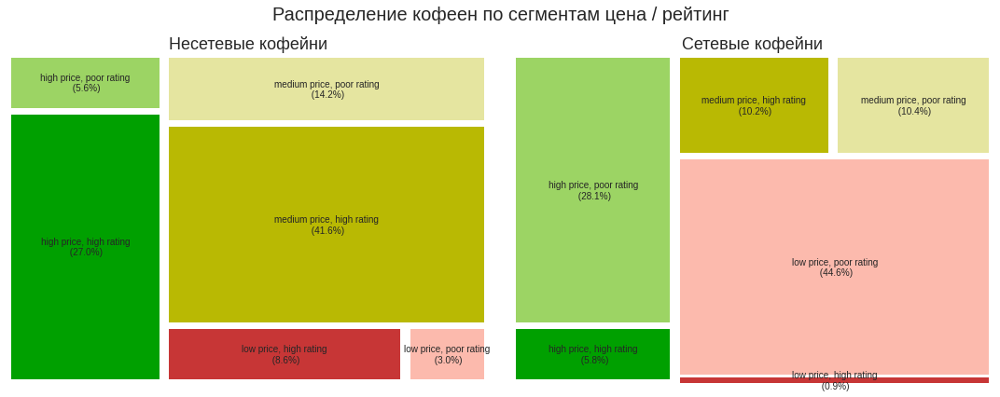

In [115]:
plt.figure(figsize=(15, 6), tight_layout=True)

plt.suptitle('Распределение кофеен по сегментам цена / рейтинг', fontsize= 20)

labels_chain = cofee_shop_by_segment.apply(lambda x: str(x['segment']) + "\n (" + str(x['chain']) + ")", axis=1)
labels_not_chain = cofee_shop_by_segment.apply(lambda x: str(x['segment']) + "\n (" + str(x['not_chain']) + ")", axis=1)
colors = ['#00a000', '#9cd464', '#c73636', '#fcbaad', '#b9b903', '#e5e5a0']

ax1 = plt.subplot(1, 2,1)
squarify.plot(sizes = cofee_shop_by_segment['несетевое'], label = labels_not_chain, pad = 0.1, color = colors)
plt.axis("off")
plt.title('Несетевые кофейни', fontsize= 18)

ax2 = plt.subplot(1, 2,2)
squarify.plot(sizes = cofee_shop_by_segment['сетевое'], label = labels_chain, pad = 0.1, color = colors)
plt.axis("off")
plt.title('Сетевые кофейни', fontsize= 18)

plt.show() 

В несетевых кофейнях преобладают заведения с рейтингом выше среднего в верхнем и среднем ценовых сегментах.
В сетевых кофейнях преобладают заведения с рейтингом ниже среднего, в низком и высоком ценовом сегменте.

<a id="subart42"></a>
### распределение кофеен по округам

In [116]:
coffee_shop_by_district = coffee_shop_data.groupby('district')['name'].count().sort_values(ascending = False).reset_index(name = 'count')
coffee_shop_by_district['district_share'] = (coffee_shop_by_district['count'] / coffee_shop_by_district['count'].sum()).map(lambda x: '{0:.1%}'.format(x))
coffee_shop_by_district

,district,count,district_share
0,Центральный административный округ,428,30.3%
1,Северный административный округ,193,13.7%
2,Северо-Восточный административный округ,159,11.3%
3,Западный административный округ,150,10.6%
4,Южный административный округ,131,9.3%
5,Восточный административный округ,105,7.4%
6,Юго-Западный административный округ,96,6.8%
7,Юго-Восточный административный округ,89,6.3%
8,Северо-Западный административный округ,62,4.4%


In [117]:
coffee_chain_by_district = coffee_shop_data.query('chain == "сетевое"').groupby('district')['name'].count().sort_values(ascending = False).reset_index(name = 'count')
coffee_chain_by_district['district_share'] = (coffee_chain_by_district['count'] / coffee_chain_by_district['count'].sum()).map(lambda x: '{0:.1%}'.format(x))
coffee_chain_by_district

,district,count,district_share
0,Центральный административный округ,221,30.7%
1,Северный административный округ,97,13.5%
2,Западный административный округ,93,12.9%
3,Северо-Восточный административный округ,79,11.0%
4,Южный административный округ,66,9.2%
5,Восточный административный округ,51,7.1%
6,Юго-Западный административный округ,50,6.9%
7,Северо-Западный административный округ,34,4.7%
8,Юго-Восточный административный округ,29,4.0%


In [118]:
coffee_chain_by_district = coffee_shop_data.pivot_table(index = 'district', columns = 'chain', values = 'name', aggfunc = 'count')
coffee_chain_by_district['total']=coffee_chain_by_district['сетевое']+coffee_chain_by_district['несетевое']
coffee_chain_by_district['chain_share'] = (coffee_chain_by_district['сетевое']/coffee_chain_by_district['total']).map(lambda x: '{0:.1%}'.format(x))
coffee_chain_by_district = coffee_chain_by_district.sort_values(by='сетевое', ascending = False).reset_index()
coffee_chain_by_district 

chain,district,несетевое,сетевое,total,chain_share
0,Центральный административный округ,207,221,428,51.6%
1,Северный административный округ,96,97,193,50.3%
2,Западный административный округ,57,93,150,62.0%
3,Северо-Восточный административный округ,80,79,159,49.7%
4,Южный административный округ,65,66,131,50.4%
5,Восточный административный округ,54,51,105,48.6%
6,Юго-Западный административный округ,46,50,96,52.1%
7,Северо-Западный административный округ,28,34,62,54.8%
8,Юго-Восточный административный округ,60,29,89,32.6%


In [119]:
fig = px.bar(coffee_chain_by_district,
             y ='сетевое', 
             color = 'district',
             text='сетевое',
             color_discrete_sequence=['#CAD3C8','#0652DD','#EE5A24','#A3CB38','#009432','#FFC312','#ED4C67','#F79F1F','#12CBC4']
             )

fig.update_layout(title='Количество сетевых кофеен по административным районам Москвы',
                   xaxis_title='Район',
                   yaxis_title='Количество заведений',
                   legend_title = 'Район',
                   )
                                  
fig.update_xaxes(categoryorder='array', categoryarray= list(reversed( coffee_chain_by_district['district'])))
fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()

In [120]:
moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles="Cartodb Positron")

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

coffee_shop_data.query('chain == "сетевое"').apply(create_clusters, axis=1)

m

In [121]:
coffe_shop_rating_by_district = coffee_shop_data.groupby('district')['rating'].mean().round(2).sort_values(ascending = False).reset_index()
coffe_shop_rating_by_district

,district,rating
0,Центральный административный округ,4.34
1,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
3,Восточный административный округ,4.28
4,Юго-Западный административный округ,4.28
5,Юго-Восточный административный округ,4.23
6,Южный административный округ,4.23
7,Северо-Восточный административный округ,4.22
8,Западный административный округ,4.20


In [122]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=coffe_shop_rating_by_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Greens',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

m

In [123]:
coffe_shop_middle_cup_by_district = coffee_shop_data.groupby('district')['middle_coffee_cup'].median().round(2).sort_values(ascending = False).reset_index()
coffe_shop_middle_cup_by_district

,district,middle_coffee_cup
0,Центральный административный округ,184.5
1,Юго-Западный административный округ,170.0
2,Западный административный округ,165.0
3,Северо-Восточный административный округ,157.5
4,Северный административный округ,150.0
5,Южный административный округ,144.0
6,Северо-Западный административный округ,135.0
7,Восточный административный округ,134.5
8,Юго-Восточный административный округ,126.0


In [124]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=coffe_shop_middle_cup_by_district,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='Greens',
    fill_opacity=0.8,
    legend_name='Средняя стоимость чашки кофе по районам',
).add_to(m)

m

<a id="subart43"></a>
### оценка наличия круглосуточных кофеен

In [125]:
round((len(coffee_shop_data[coffee_shop_data['is_24/7'] ==True])/len(coffee_shop_data))*100,2)

4.18

In [126]:
coffee_shop_data[coffee_shop_data['is_24/7'] ==True].groupby('chain')['name'].count().reset_index()

,chain,name
0,несетевое,9
1,сетевое,50


In [127]:
coffee_shop_data[(coffee_shop_data['is_24/7'] ==True)].groupby('chain')['name'].value_counts().sort_values(ascending = False).reset_index(name='count')

,chain,name,count
0,сетевое,шоколадница,17
1,сетевое,wild bean,12
2,сетевое,кофемания,8
3,сетевое,кофе хауз,3
4,сетевое,кофе с собой,2
5,сетевое,you&coffee,2
6,сетевое,cofix,2
7,сетевое,one&double,1
8,сетевое,one price coffee,1
9,сетевое,cinnabon,1


In [128]:
coffee_shop_data[coffee_shop_data['is_24/7'] ==True].groupby('district')['name'].count().sort_values(ascending = False).reset_index()

,district,name
0,Центральный административный округ,26
1,Западный административный округ,9
2,Юго-Западный административный округ,7
3,Восточный административный округ,5
4,Северный административный округ,5
5,Северо-Восточный административный округ,3
6,Северо-Западный административный округ,2
7,Юго-Восточный административный округ,1
8,Южный административный округ,1


In [129]:
from folium import Marker

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}"
    ).add_to(m)

coffee_shop_data[coffee_shop_data['is_24/7'] ==True].apply(create_marker, axis=1)
    

m

Выводы: среди кофеен всего 4% круглосуточных заведений. Они расположены преимущественно в центре, при этом некоторе количество кофеен распоожены вдоль больших шоссе ближде к МКАД.  
Среди круглосуточных кофеен преобладают сетевые.  

<a id="subart44"></a>
### основные выводы по категории кофеен

Всего в Москве 1413 кофеен

Сетевые заведения имеют большое значение для категории кофеен. Доля сетей составляет 51%. Поэтому важно учитывать расположение сетевых кофеен, особенности их позиционирования по цене и рейтингам.

Большая часть несетевых заведений попадает в сегменты с высоким рейтингом, средней и высокой ценовой категории. 
Большая часть сетевых заведений попадает в сегменты с низким рейтингом, в низкий и высокий ценовой сегмент.  Сетевые заведения слабо представлены в среднем ценовом сегменте.

Выводы. Наиболее оптимальными условиями для открытия  кофейни являются:
- Районы с низкой численностью сетевых кофеен. Несмотря на более низкий рейтинг сети обладают бОльшей известностью.
- Районы с более высокой стоимостью чашки капучино. При этом стоит ориентироваться на стоимость чашки капучино в среднем ценовом диапазоне: от 120 до 200
- Районы с более высоким средним рейтингом предпочтительны за счет более благоприятного окружения.

В наибольшей степени этим критериям соответствует Юго-Западный округ


<a id="article5"></a>
## Общие итоги по проекту

В рамках исследования был проанализирован рынок общепита Москвы. 
Были определены основные категории общественного питания. Сделано сравнительных анализ по среднему рейтингу и среднему чеку.

Было сделано исследование по округам по количеству заведений, среднему чеку и  рейтингу.

Так же был проведен анализ сетевых заведений: их общая доля, и доля присутствия в каждой из категорий. Были определены их основные особенности с точки зрения ценового позиционирования и средних рейтингов.


Отдельно, более подробно был проведено исследование категории кофеен. 
Сделан сравнительный анализ сетевых и несетевых заведений: сегментация по уровню стоимости чашки кофе и рейтингу. Были определены округа с наиболее оптимальными условиями для открытия кофейни: низкое присутствие сетевых кофеен, стоимость чашки кофе выше среднего, и высокий средний рейтинг заведений. А так же даны рекомендации по ценообразованию.

<a id="article6"></a>
## Материалы

[Презентация:](https://disk.yandex.ru/i/LhN9Due66Go8mg)  https://disk.yandex.ru/i/LhN9Due66Go8mg